In [6]:
import numpy as np
import scipy.io

In [7]:
f = open('scrambled.mat')

In [8]:
for i in range(5):
    f.readline()

In [9]:
m = []

In [10]:
line = f.readline()
while line[1:]!='':
    val = int(line[1:])
    m.append(val)
    line = f.readline()

In [11]:
x = np.array(m)
mat = x.reshape(512,512).T

In [12]:
import matplotlib.pyplot as plt

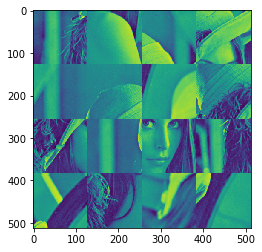

In [13]:
plt.imshow(mat)

In [14]:
x = np.arange(0,4)
y = np.arange(0,4)
np.random.shuffle(x)
np.random.shuffle(y)
x,y

(array([2, 0, 3, 1]), array([1, 3, 0, 2]))

In [15]:
mat[128*x[0]:128*x[0]+128, 128*y[0]:128*y[0]+128]

array([[ 93,  93,  95, ..., 215, 201, 195],
       [ 92,  92,  95, ..., 214, 207, 188],
       [ 95,  95,  96, ..., 210, 212, 185],
       ...,
       [ 99,  99, 102, ..., 140, 144, 143],
       [ 99,  99, 104, ..., 148, 146, 144],
       [ 99,  99, 100, ..., 153, 153, 149]])

In [65]:
class Energy:
    def __init__(self, image):
        self.image = image
        self.height = 4
        self.width = 4

    def getLeftRightEnergy(self, tile):
        i, j = tile
        x1 = 128 * i
        x2 = 128 * (i + 1)
        y = 128 * (j + 1) - 1
        diff = self.image[x1:x2,y] - self.image[x1:x2,y + 1]
        return np.sqrt((diff**2).mean())

    def getUpDownEnergy(self, tile):
        i, j = tile
        y1 = 128 * j
        y2 = 128 * (j + 1)
        x = 128 * (i + 1) - 1
        diff = self.image[x, y1:y2] - self.image[x + 1, y1:y2]
        return np.sqrt((diff**2).mean())

    def getEnergyAround(self, tile):
        i, j = tile
        e = np.zeros(4)
        e[0] = self.getLeftRightEnergy((i,j-1))
        e[1] = self.getLeftRightEnergy((i,j))
        e[2] = self.getUpDownEnergy((i-1,j))
        e[3] = self.getUpDownEnergy((i,j))
        return e.sum()

    def getEnergyAround2Tiles(self, t1, t2):
        return self.getEnergyAround(t1) + self.getEnergyAround(t2)

    def energy(self):
        energy = 0
        for i in range(1, self.height - 1):
            for j in range(1, self.width - 1):
                energy += self.getEnergyAround((i, j))
        return energy

    def cheatEnergy(self):                             # for testing purposes only, not used in the algorithm obviously
        return np.linalg.norm(self.image - original)

In [67]:
e = Energy(image = mat)
e.energy()

1035.15508413872

In [83]:
class Proposal:
    # sigma = 20, t=200->5, steps=10**6, final energy value 19.6k, cheat energy 25.3k 
    # sigma = 40, t=200->5, steps=10**6, final energy value 21.6k, cheat energy 37k
    # sigma = 30, t=200->5, steps=3*10**6, final energy value 
    def __init__(self, data, priorityRecomputeRate = 10**3, sigma = 30): 
        self.sigma = sigma
        self.priorityRecomputeRate = priorityRecomputeRate
        self.data = data
        self.counter = 0
        self.height = self.data.height
        self.width = self.data.width
        self.numTiles = (self.height - 2) * (self.width - 2)
        self.indices = [(i,j) for i in range(1, self.height - 1) for j in range(1, self.width - 1)]
        self.computeEnergies()
        self.sortedTiles = []

    def computeEnergies(self):
        #self.sortedTiles = list(map(lambda i,j: Energy(self.data).getEnergyAround((i,j)), (i,j)), self.indices) 

        for index in self.indices:
            e = Energy(self.data).getEnergyAround(index)
            self.sortedTiles.append((e, index))
        self.sortedTiles.sort(reverse=True)

    def get(self):
        self.counter += 1
        if (self.counter % self.priorityRecomputeRate == 0):
            self.counter = 0
            self.computeEnergies()
        i1 = 0
        i2 = 0
        while i1 == i2:
            i1, i2 = np.round(np.clip(np.abs(np.random.normal(0, self.sigma, 2)), 0, self.numTiles - 1)).astype(int)
        _, t1 = self.sortedTiles[i1]
        _, t2 = self.sortedTiles[i2]
        return [t1, t2]


970.3914672850899 995.0


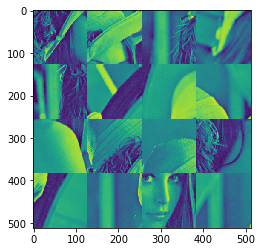

1077.7895051520597 990.025


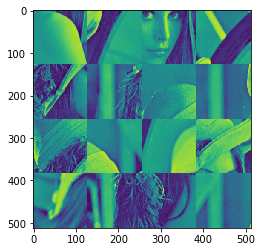

893.6835769379509 985.074875


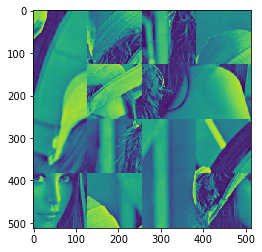

1056.4385051256102 980.149500625


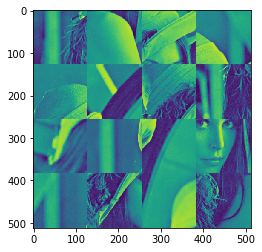

908.8710307703363 975.248753121875


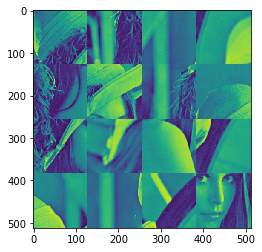

962.918681033771 970.3725093562656


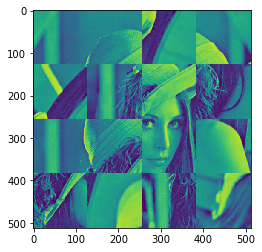

1092.4725232495264 965.5206468094842


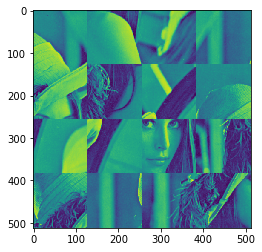

1071.1300724470775 960.6930435754368


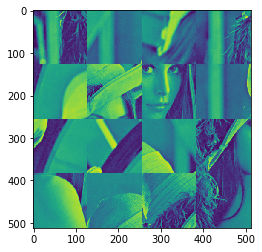

1309.9177929572097 955.8895783575597


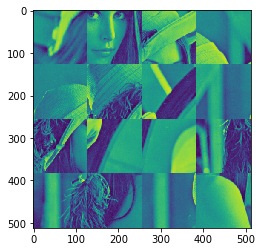

964.7168507953725 951.1101304657719


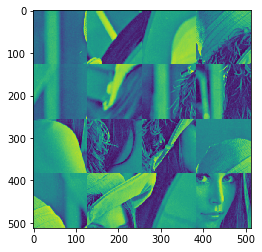

1048.959242259088 946.354579813443


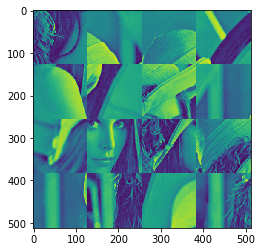

841.8536413724182 941.6228069143758


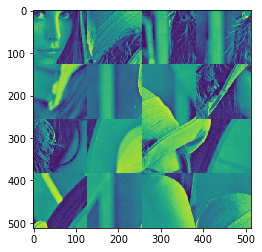

1113.5563434162887 936.914692879804


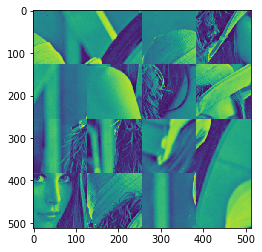

1042.7123340133194 932.2301194154049


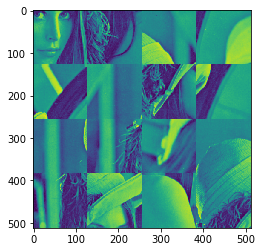

922.8193647257855 927.5689688183279


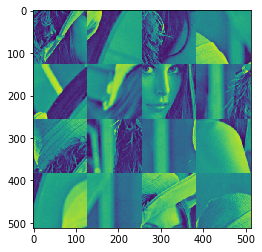

1096.555557190919 922.9311239742362


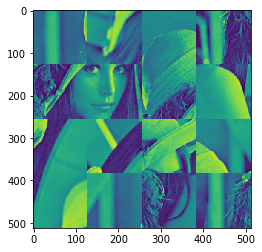

1197.547064096913 918.316468354365


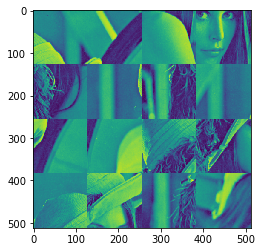

1070.9536934939667 913.7248860125932


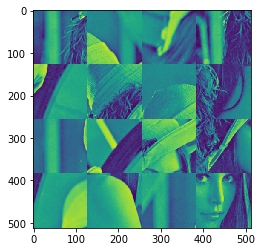

823.2941662810815 909.1562615825302


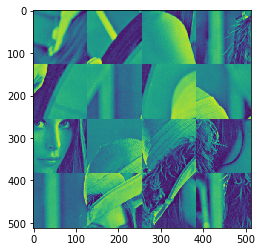

1043.0860240498114 904.6104802746175


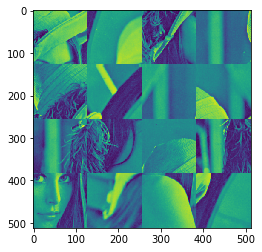

858.1052992172822 900.0874278732445


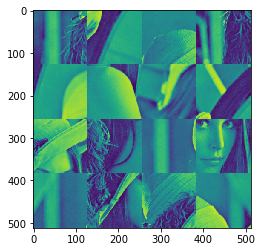

1059.0212683143607 895.5869907338782


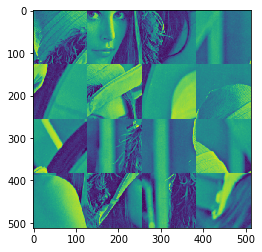

900.1390784630369 891.1090557802088


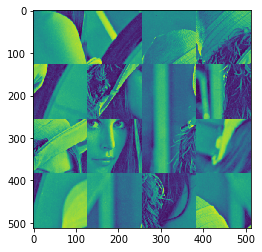

1103.4450260202818 886.6535105013078


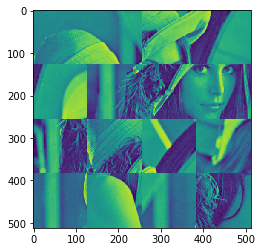

1004.233958465473 882.2202429488012


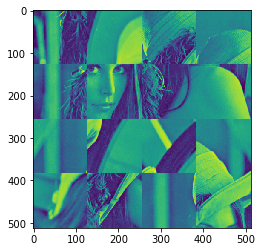

922.669478968076 877.8091417340572


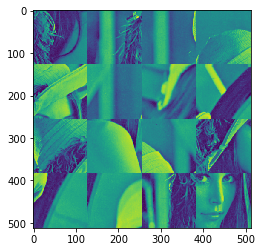

1138.0324321352334 873.4200960253869


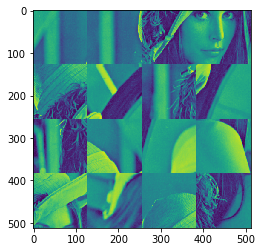

976.0453584722452 869.0529955452599


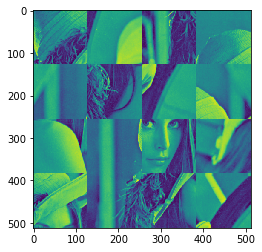

1100.654876488235 864.7077305675336


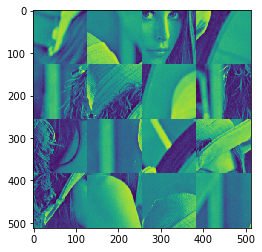

890.388523086673 860.384191914696


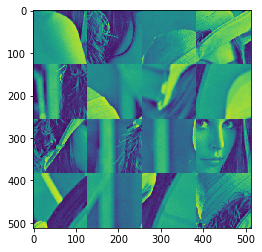

1168.6512933880035 856.0822709551225


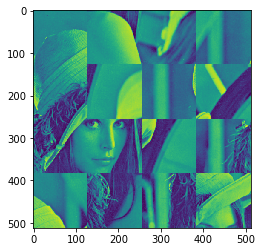

1171.0373221532282 851.8018596003468


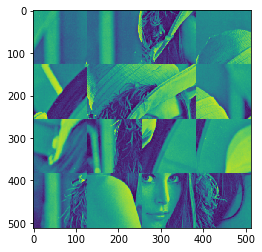

1117.5044788573919 847.5428503023451


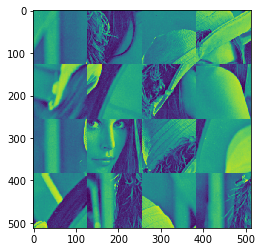

1116.844329142371 843.3051360508333


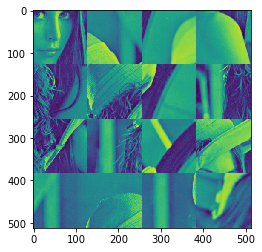

881.4967306777158 839.0886103705791


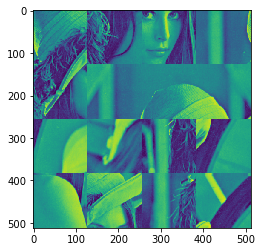

989.2129173371773 834.8931673187262


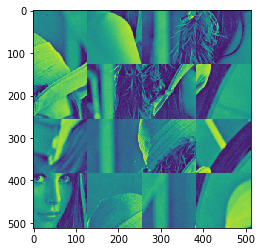

1063.002374661408 830.7187014821326


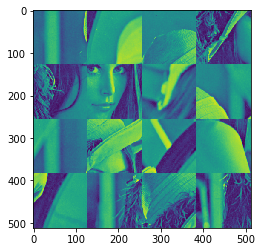

1089.7403601355604 826.565107974722


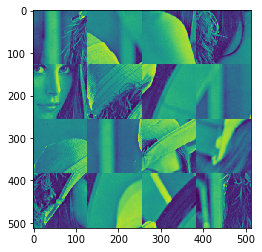

931.5434381321161 822.4322824348484


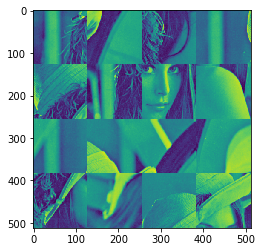

948.3161128527602 818.3201210226741


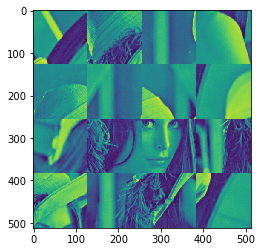

992.2580029686331 814.2285204175607


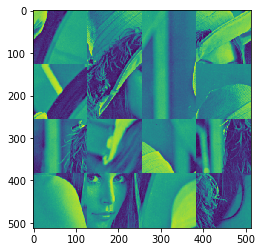

829.0512349696505 810.157377815473


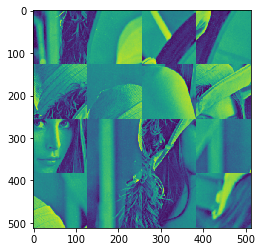

1006.5314034511774 806.1065909263956


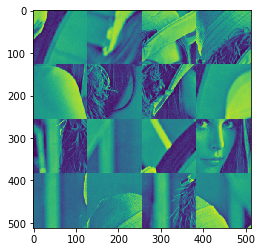

1191.4777836674505 802.0760579717636


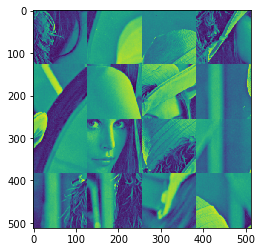

888.2470657196379 798.0656776819047


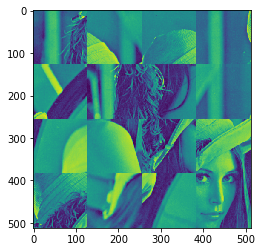

1005.5436078325768 794.0753492934952


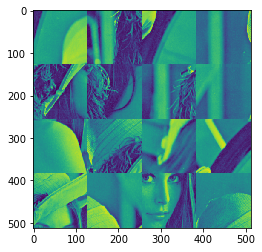

1179.7146098786648 790.1049725470277


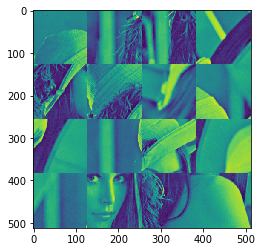

997.0989663668688 786.1544476842926


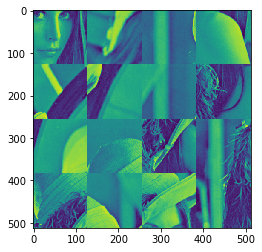

1172.331839905472 782.2236754458711


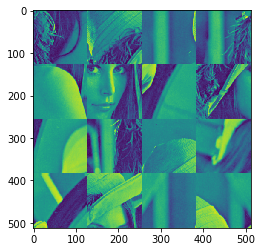

957.2597842592616 778.3125570686417


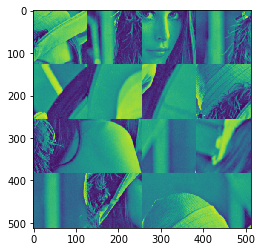

1121.3075871874623 774.4209942832985


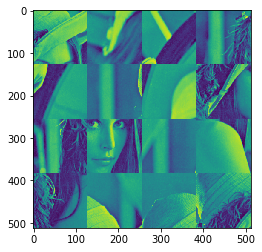

869.7097032785174 770.5488893118819


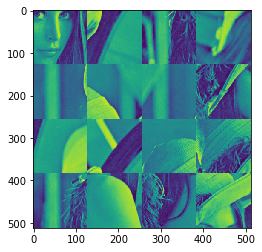

897.889097342677 766.6961448653225


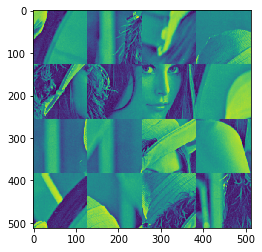

905.7598598891813 762.8626641409959


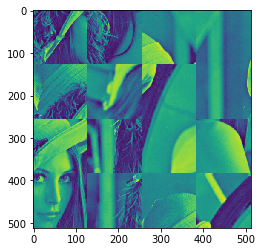

772.9385282612981 759.0483508202909


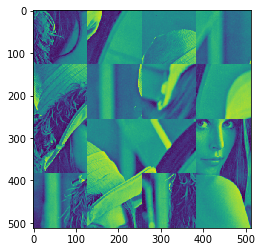

985.5917780159036 755.2531090661895


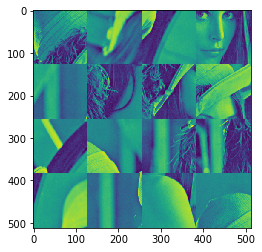

937.8158448793606 751.4768435208586


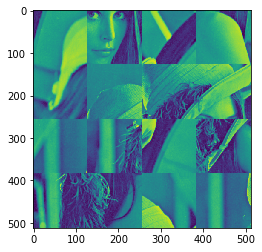

994.5869765080076 747.7194593032542


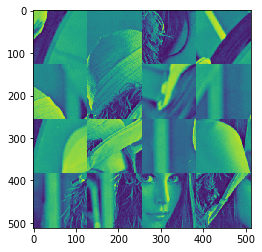

1110.164484801151 743.980862006738


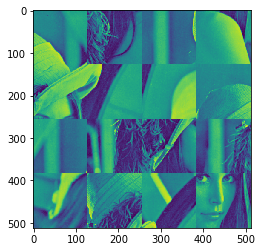

1017.6272582846539 740.2609576967043


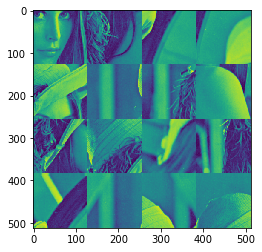

965.6382971047663 736.5596529082208


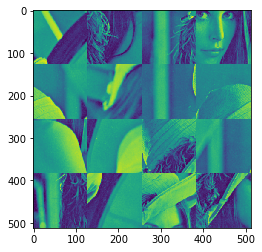

918.432949838262 732.8768546436796


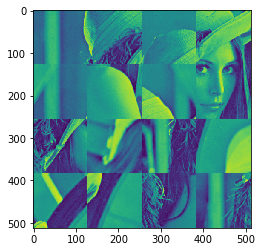

889.1796724334608 729.2124703704612


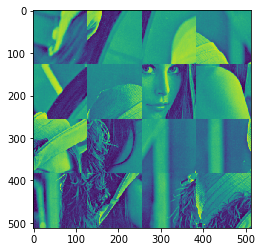

1039.8965179663708 725.566408018609


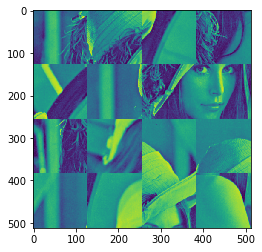

975.9631939984472 721.9385759785159


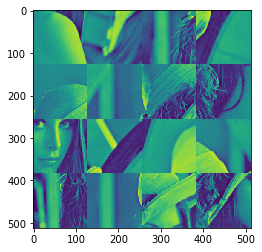

983.2608163271937 718.3288830986234


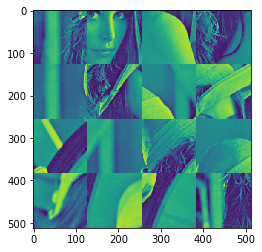

959.1879862973343 714.7372386831303


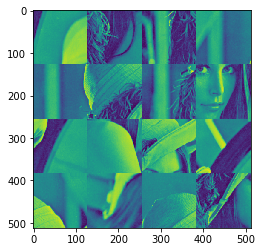

1277.692149697725 711.1635524897146


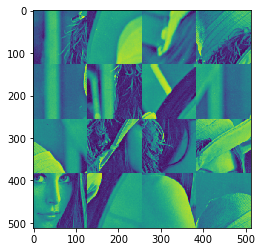

896.3316068263998 707.607734727266


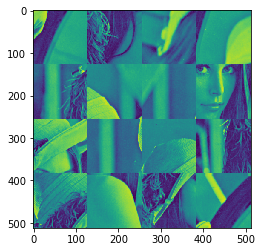

956.3437061254176 704.0696960536296


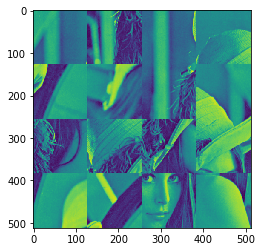

1105.3327545545217 700.5493475733615


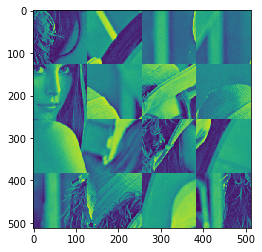

956.7238447245556 697.0466008354947


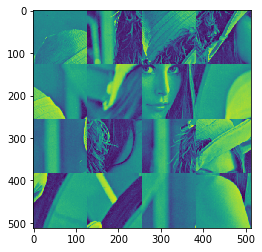

977.2591254357994 693.5613678313172


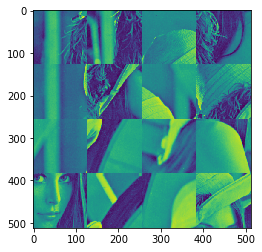

1032.820256355505 690.0935609921606


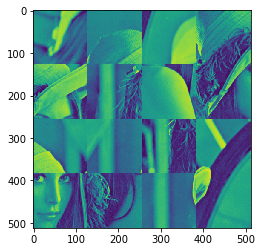

909.3099133868466 686.6430931871998


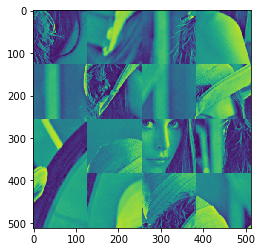

908.784477333801 683.2098777212639


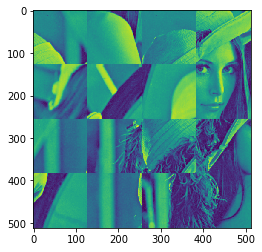

1237.976769263998 679.7938283326575


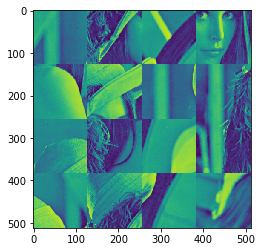

1173.4073572932216 676.3948591909942


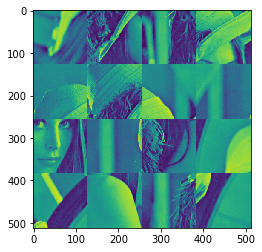

1048.8410110733846 673.0128848950393


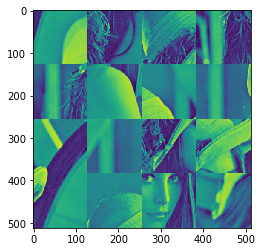

1036.670220739842 669.647820470564


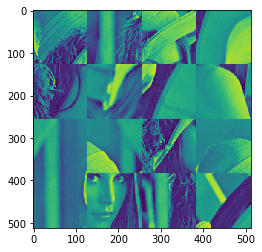

1026.8725686095022 666.2995813682112


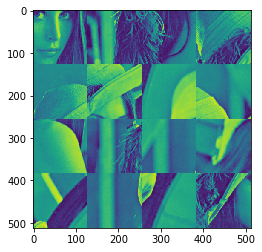

998.6276269848028 662.9680834613702


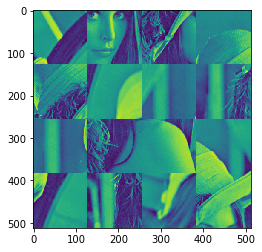

1156.305056910212 659.6532430440633


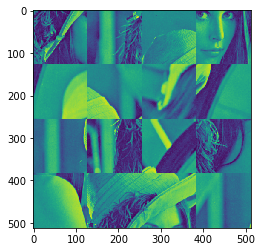

895.9908594095884 656.354976828843


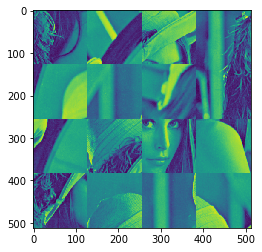

1253.564881508264 653.0732019446988


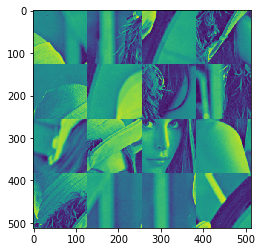

1004.762604161474 649.8078359349753


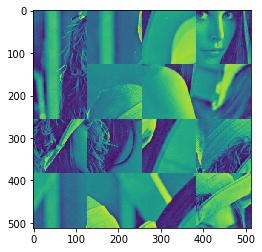

1184.9109410723995 646.5587967553004


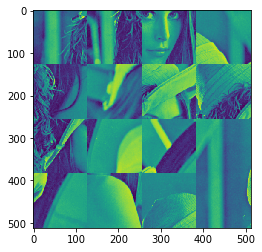

1086.413838725933 643.3260027715238


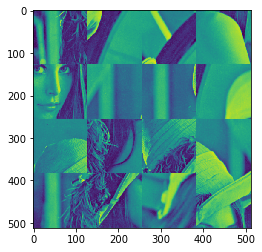

1016.5104898079237 640.1093727576662


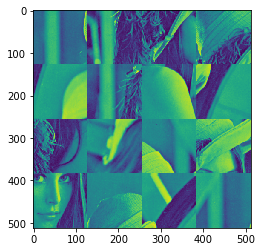

821.4977757869757 636.9088258938779


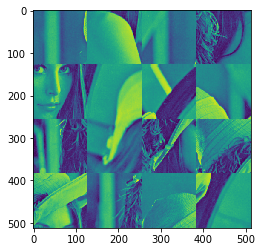

867.373014093422 633.7242817644085


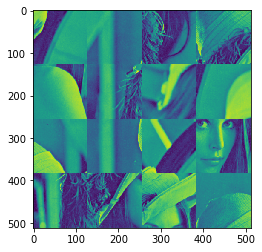

1076.6527435189605 630.5556603555865


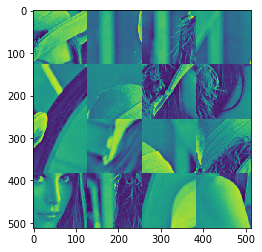

1098.8090675073076 627.4028820538085


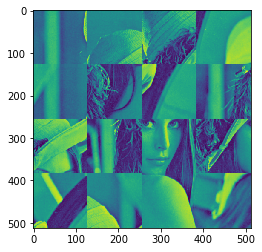

1041.798614921428 624.2658676435395


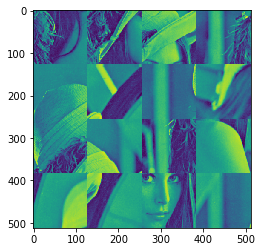

895.3896987720119 621.1445383053218


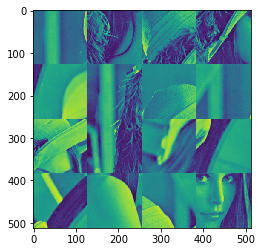

934.2118159851357 618.0388156137952


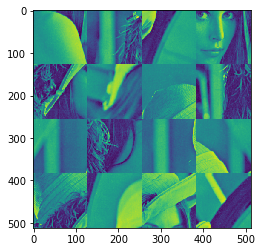

1041.6552855726995 614.9486215357263


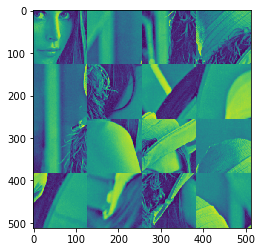

948.2723068442294 611.8738784280476


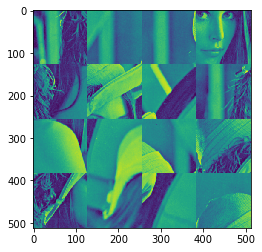

1186.3539502236672 608.8145090359073


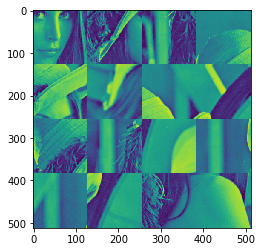

761.2934750027915 605.7704364907278


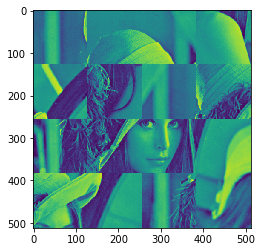

1134.1945650026414 602.7415843082741


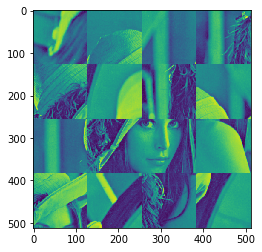

1013.0231417455728 599.7278763867328


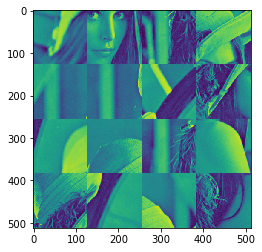

933.1533874911686 596.7292370047991


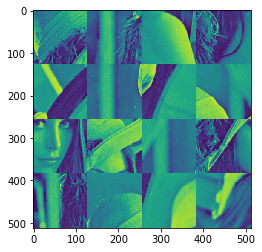

914.4689142287773 593.7455908197751


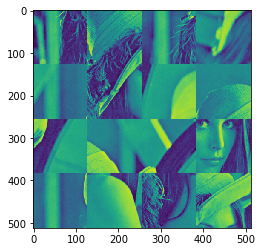

1001.7672923913062 590.7768628656762


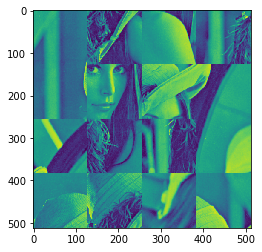

1010.0032763318897 587.8229785513478


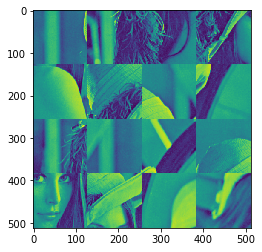

644.8966860999634 584.883863658591


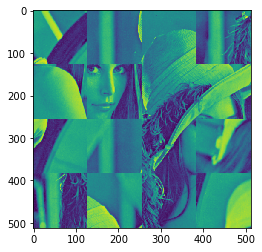

1015.3550031374392 581.9594443402981


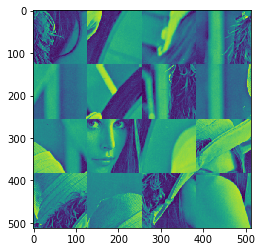

995.3974127681852 579.0496471185966


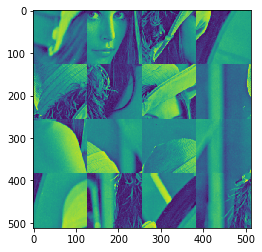

921.8482417197577 576.1543988830036


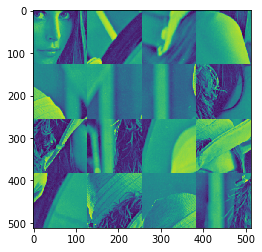

957.0832048648435 573.2736268885886


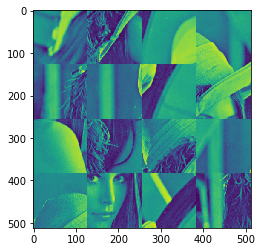

1036.669258719776 570.4072587541457


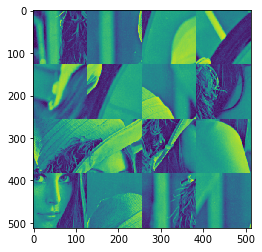

854.6241117406483 567.5552224603749


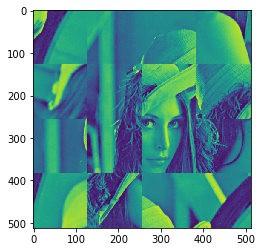

969.0596755868559 564.717446348073


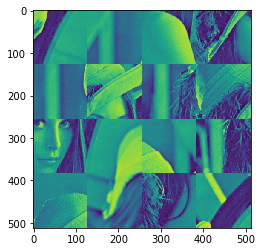

971.5212637706553 561.8938591163327


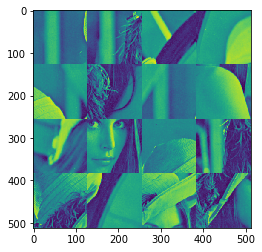

1053.23576329947 559.084389820751


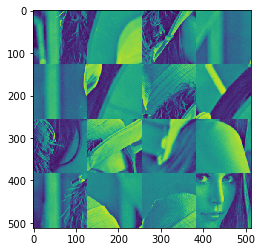

953.992723486836 556.2889678716472


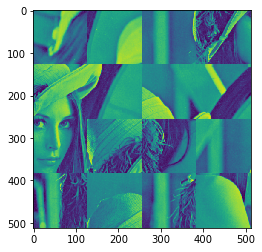

770.9492699229124 553.507523032289


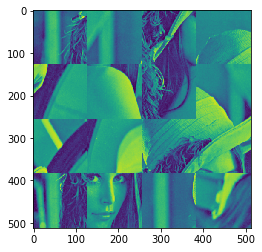

1334.1666497355002 550.7399854171275


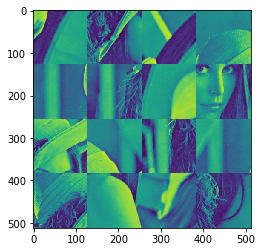

1035.3681205499659 547.9862854900418


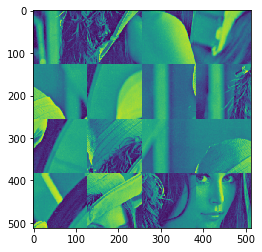

1057.2959582510075 545.2463540625916


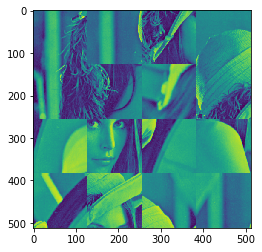

1223.8252195637285 542.5201222922786


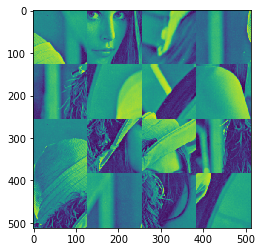

1023.4651692709235 539.8075216808172


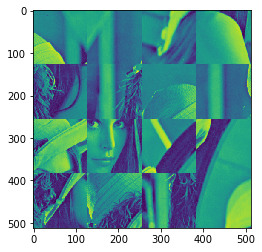

1016.7381538313953 537.1084840724131


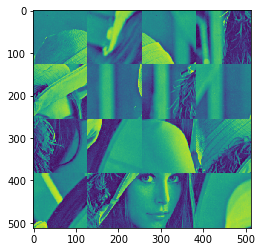

1056.6845213460037 534.4229416520511


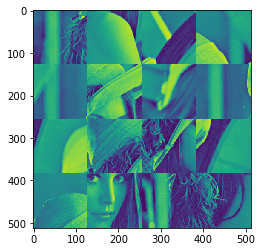

789.9072035277396 531.7508269437909


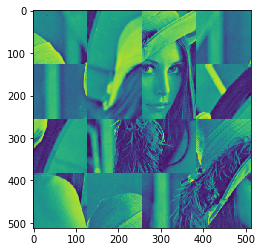

1101.7295521456265 529.092072809072


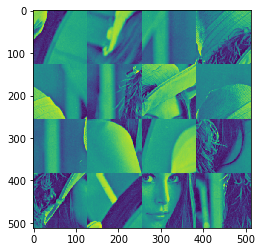

887.3382198956235 526.4466124450266


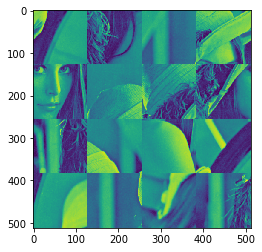

983.097107712139 523.8143793828015


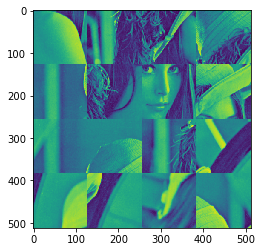

653.4046942143635 521.1953074858875


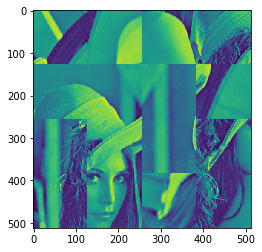

912.3808953046002 518.589330948458


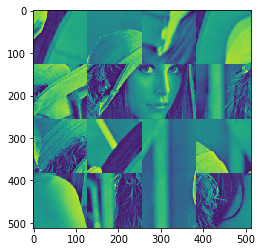

1037.9593699194984 515.9963842937158


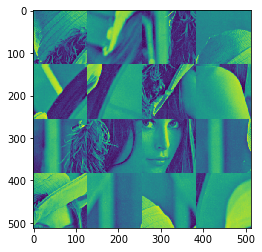

1082.9751637311758 513.4164023722471


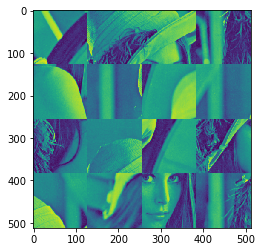

802.288808651504 510.8493203603859


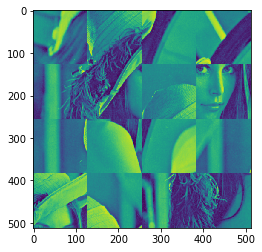

1010.2154913758367 508.29507375858395


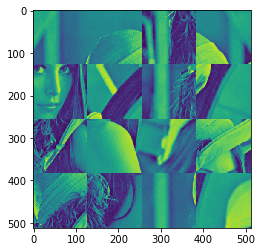

1055.9444930637737 505.753598389791


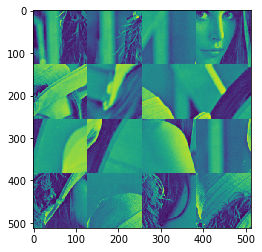

1060.8190638683877 503.2248303978421


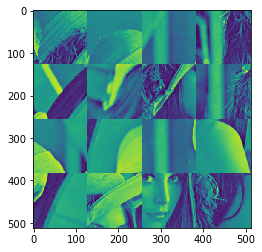

1087.1883599787025 500.70870624585285


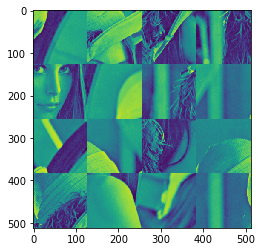

1032.9110530856224 498.2051627146236


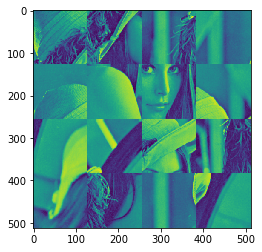

891.4274443230179 495.7141369010505


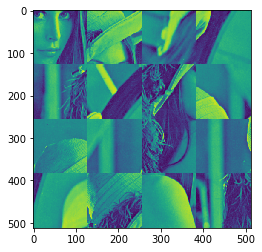

1073.827088968348 493.23556621654524


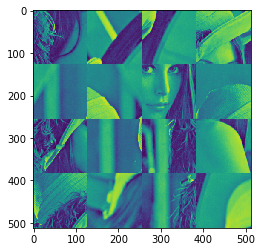

874.8382958529394 490.7693883854625


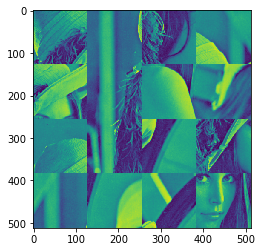

856.0250565543703 488.31554144353515


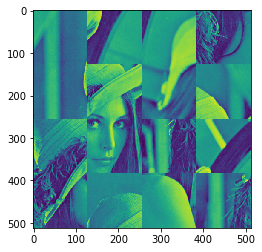

1126.84707642244 485.8739637363175


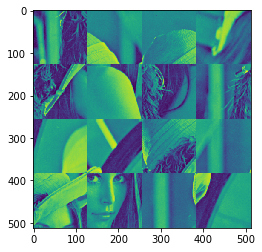

1036.320484763517 483.44459391763587


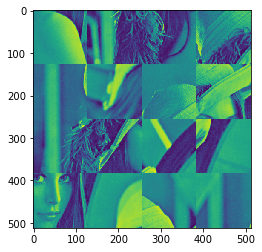

1039.4345809364042 481.0273709480477


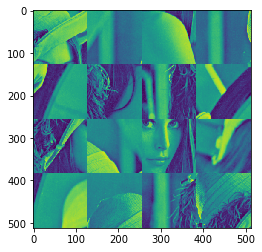

1035.6029654252393 478.62223409330744


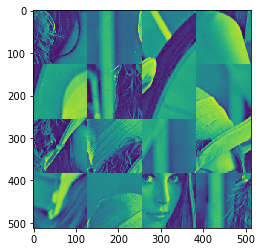

1154.6683477598115 476.22912292284093


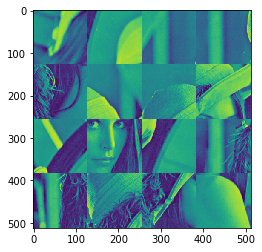

970.8788906768697 473.84797730822675


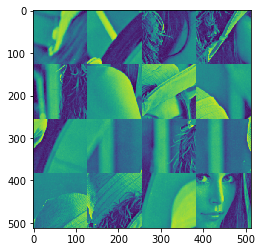

1240.821562329415 471.4787374216856


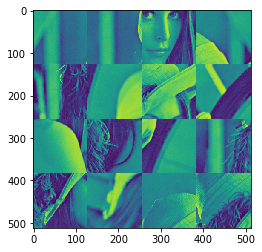

1226.3715933319932 469.1213437345772


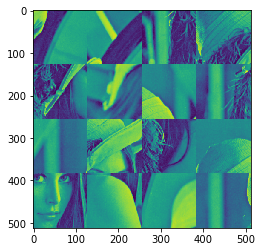

1137.8041418300193 466.77573701590427


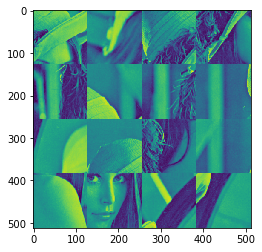

898.1142773502675 464.44185833082474


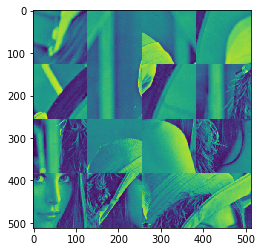

1115.773250466832 462.1196490391706


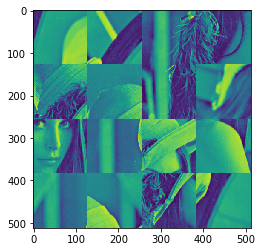

1154.624047569297 459.80905079397473


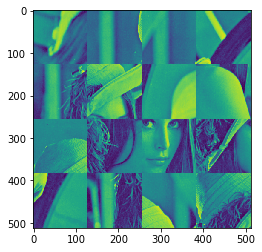

969.7911082175569 457.51000554000484


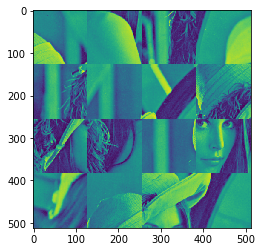

1082.3480019923518 455.2224555123048


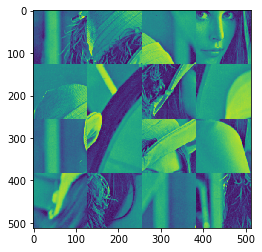

1064.008673135437 452.94634323474327


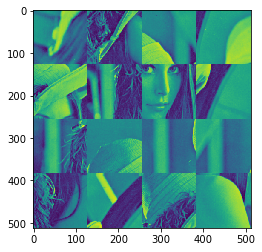

965.4016893040474 450.6816115185695


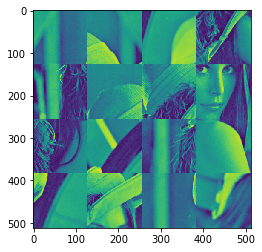

976.2117466010249 448.4282034609767


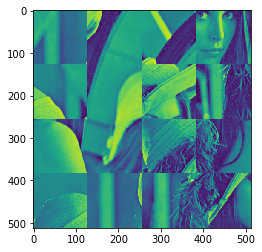

1021.0322003131522 446.1860624436718


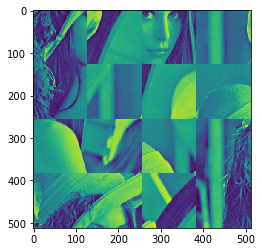

1107.4004145756037 443.95513213145347


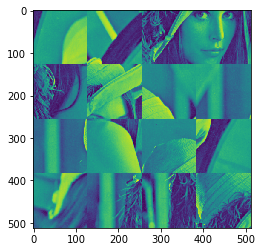

1156.0011234358358 441.7353564707962


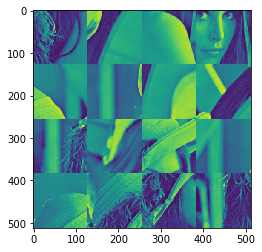

1068.5094111773283 439.52667968844224


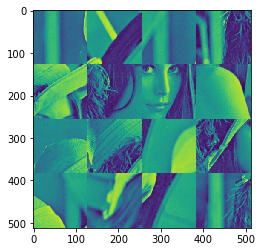

1100.405297487203 437.32904629


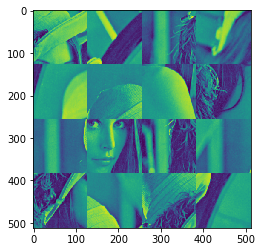

1064.99382627877 435.14240105855


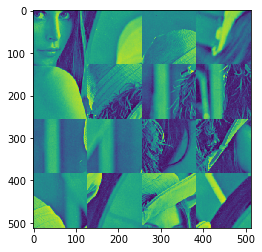

1083.1286571081002 432.96668905325726


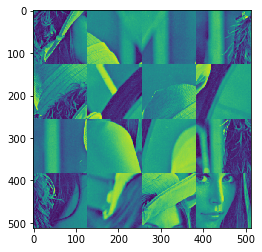

1108.1111167031436 430.80185560799094


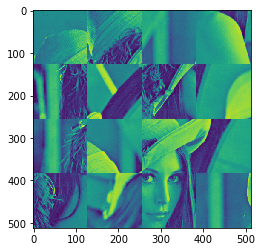

1179.0187968612472 428.647846329951


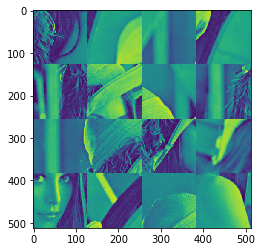

936.744349459954 426.5046070983012


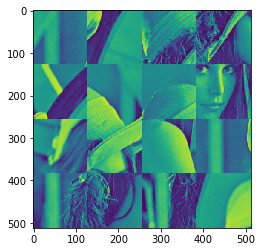

1071.1665713005345 424.37208406280973


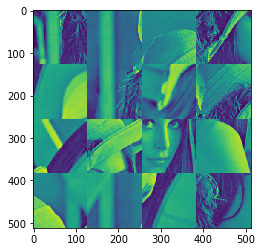

1018.5868102687491 422.25022364249565


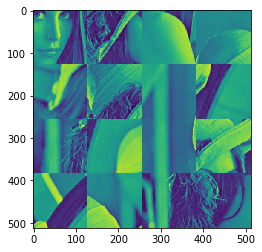

709.7383757244893 420.1389725242832


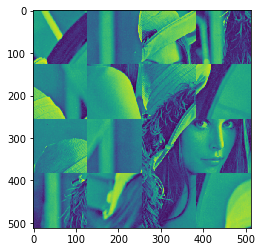

1042.8771651257503 418.03827766166177


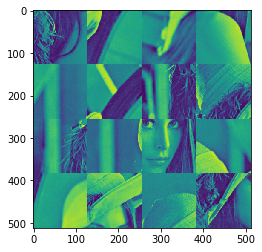

1100.7469009172107 415.94808627335345


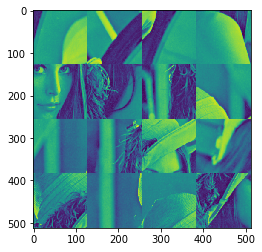

978.2952269471845 413.8683458419867


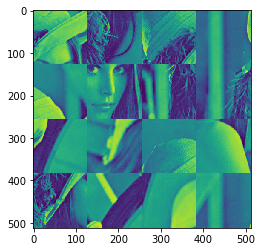

1212.6428205188854 411.79900411277674


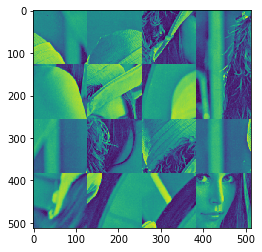

927.1119567305439 409.74000909221286


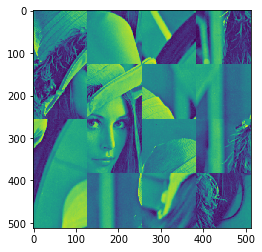

1020.878945498647 407.69130904675177


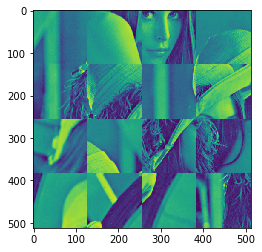

1070.5938647957278 405.652852501518


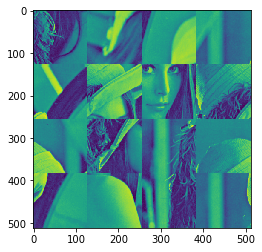

1051.176142435512 403.6245882390104


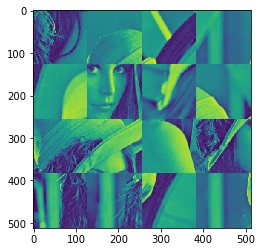

1034.8462524583288 401.60646529781536


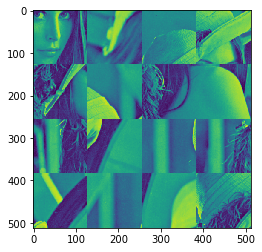

1048.8778746003936 399.5984329713263


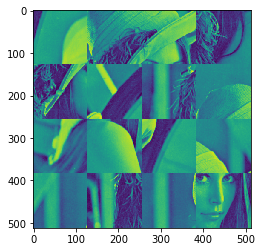

1001.2888124332728 397.6004408064697


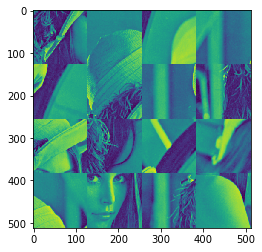

924.5587928070349 395.61243860243735


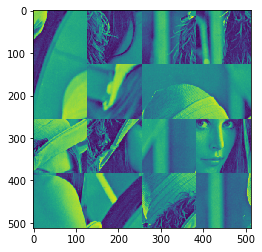

838.4275497172471 393.63437640942516


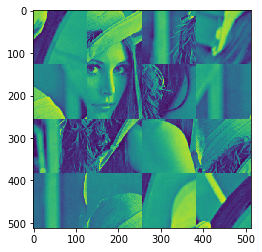

1113.7096197517649 391.66620452737806


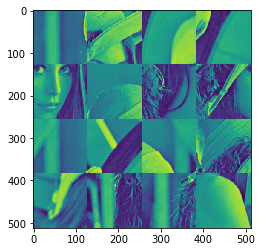

965.7539485807695 389.70787350474114


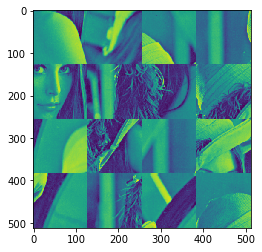

991.3529912718436 387.7593341372174


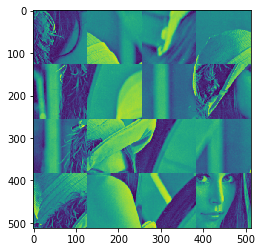

1214.8564066857462 385.82053746653133


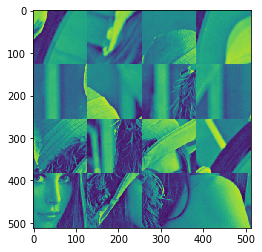

1198.671142506984 383.8914347791987


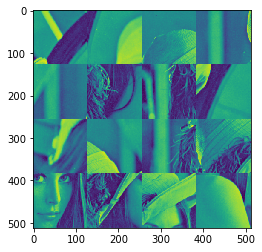

868.1722802096745 381.9719776053027


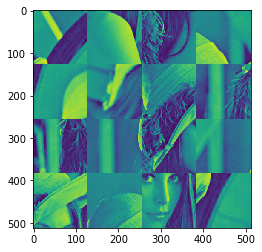

1070.671327219862 380.0621177172762


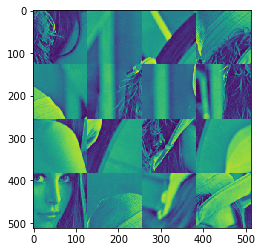

1001.2518568343999 378.1618071286898


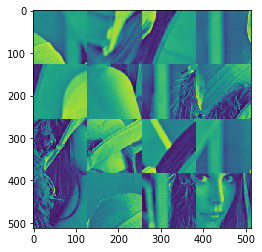

922.4466873115275 376.2709980930464


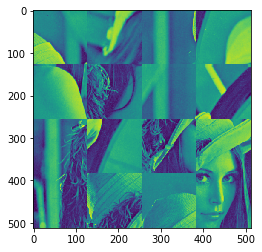

1010.2318573753926 374.38964310258115


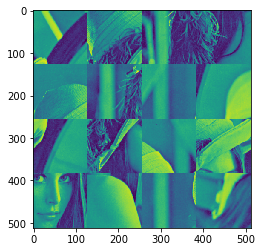

1074.7541516189399 372.5176948870682


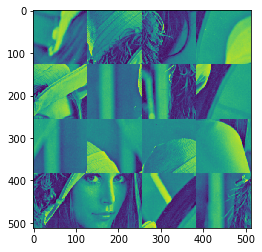

1159.3366045121816 370.65510641263285


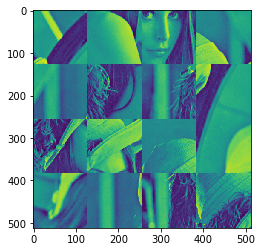

1057.923215649626 368.8018308805697


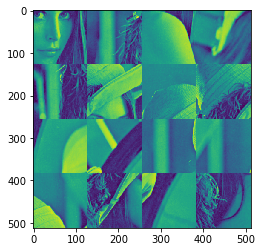

874.5617714644526 366.95782172616686


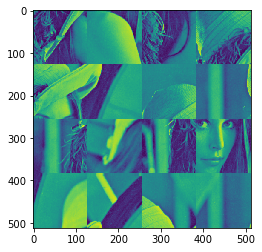

1271.995529409173 365.123032617536


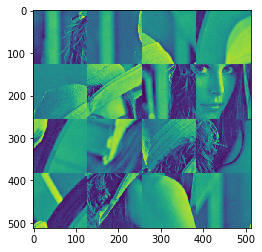

1026.3786335690265 363.29741745444835


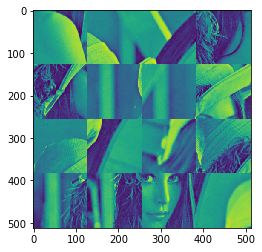

1153.1767038052835 361.4809303671761


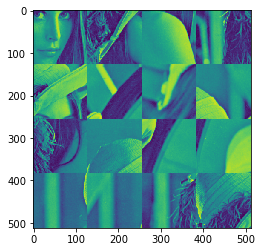

1104.8124021940448 359.6735257153402


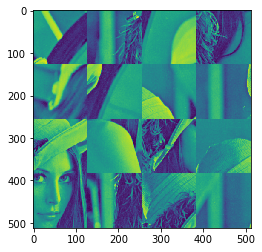

905.4961905922584 357.87515808676346


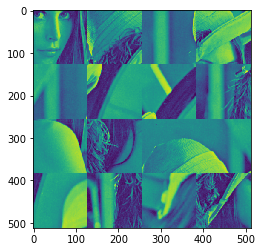

1114.385142523644 356.0857822963296


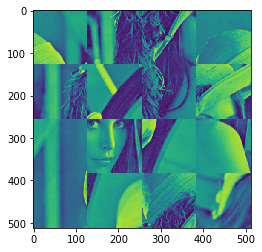

1075.8207374750104 354.305353384848


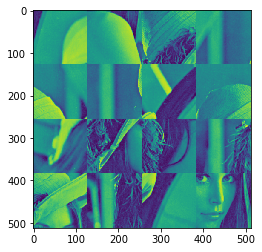

1086.2688176959562 352.53382661792375


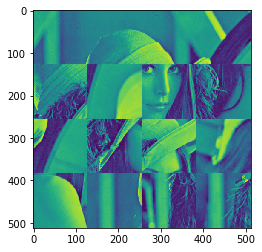

998.5258800376012 350.77115748483413


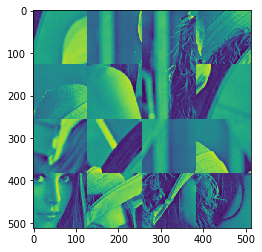

1131.8205347630735 349.01730169740995


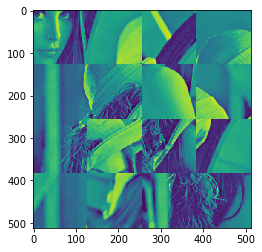

1130.9732178998167 347.27221518892287


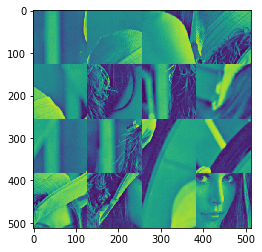

997.0318580475587 345.53585411297826


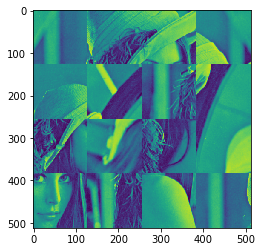

1008.0778514738205 343.80817484241334


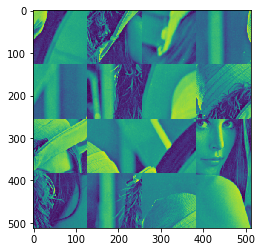

798.5612631027539 342.0891339682013


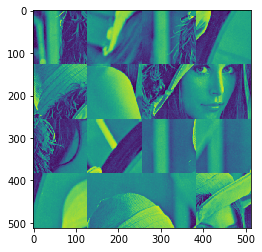

1227.6507622333147 340.37868829836026


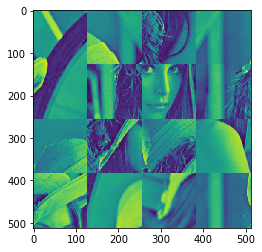

1059.6746499423484 338.67679485686847


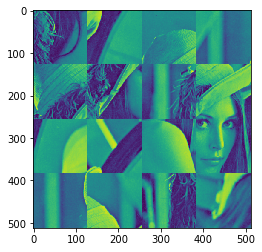

1004.0667962046459 336.9834108825841


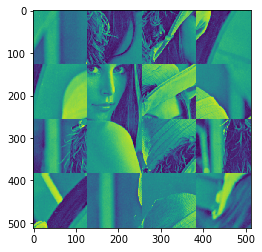

1009.1290905180604 335.29849382817116


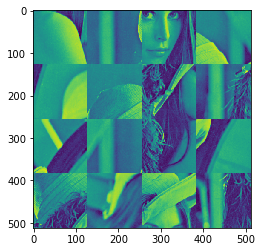

1062.8847614132692 333.6220013590303


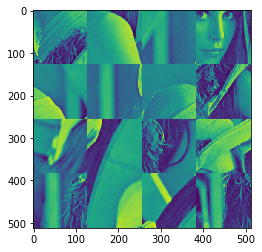

1076.279043978716 331.9538913522352


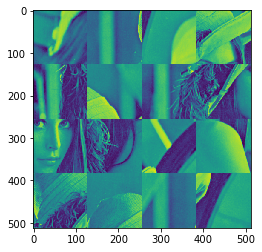

986.2633697671955 330.294121895474


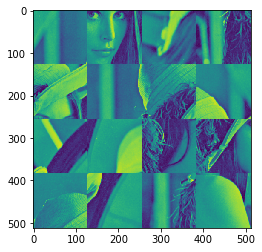

998.4917835798555 328.64265128599664


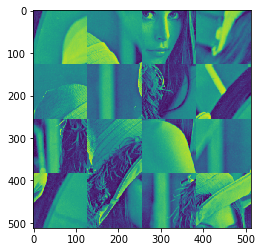

1046.4373978110057 326.99943802956665


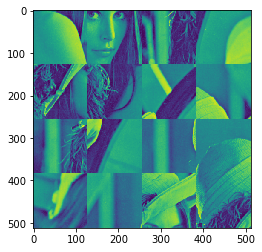

1023.2247226322338 325.3644408394188


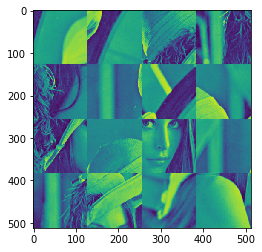

930.0090903468848 323.73761863522174


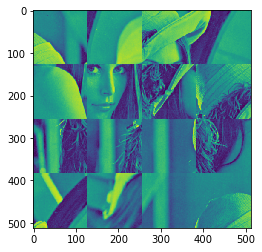

779.4725446036465 322.11893054204563


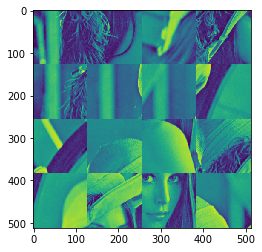

1079.2207313528781 320.5083358893354


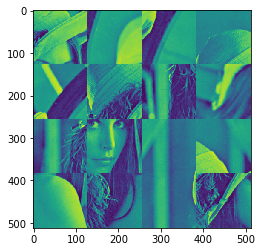

876.8464282622931 318.9057942098887


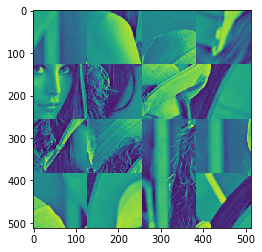

1046.3951483927558 317.31126523883927


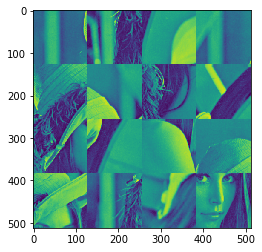

918.3617274047629 315.7247089126451


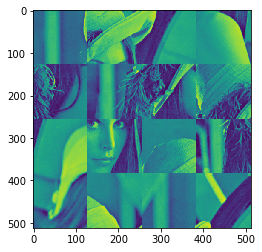

920.6925844959508 314.14608536808186


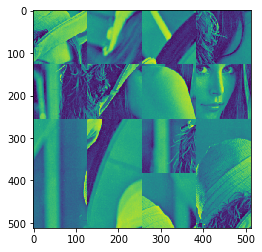

1156.5675293015543 312.57535494124147


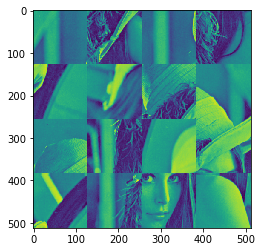

912.7659606595043 311.0124781665353


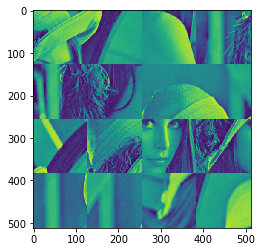

995.211090693525 309.4574157757026


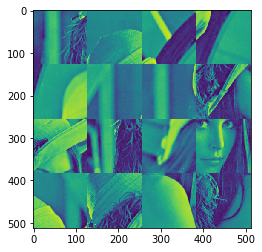

1011.2161989487925 307.9101286968241


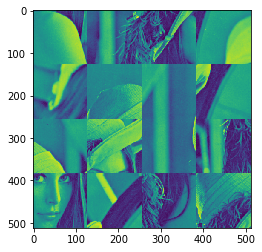

891.4349973532567 306.37057805333995


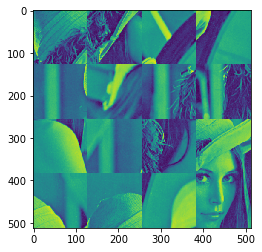

918.4463040414165 304.83872516307326


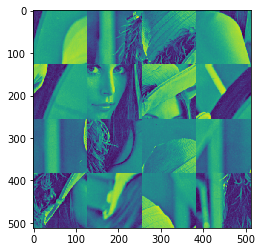

1105.9129640680785 303.3145315372579


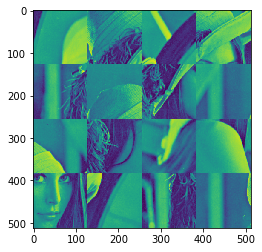

1008.1941098695514 301.7979588795716


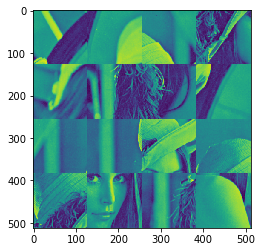

991.633519200228 300.28896908517373


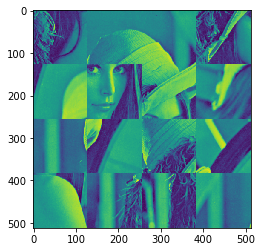

941.5533347187942 298.7875242397479


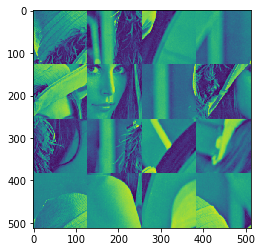

983.3736551601842 297.2935866185491


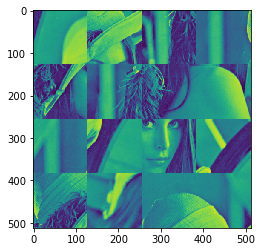

1066.4708305376375 295.8071186854564


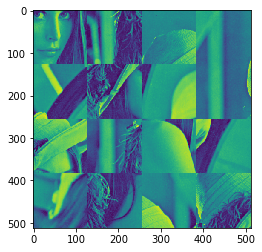

782.248986342317 294.3280830920291


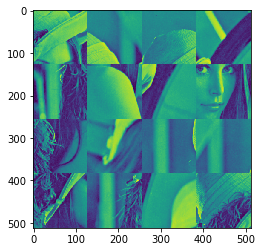

1100.2084878171527 292.8564426765689


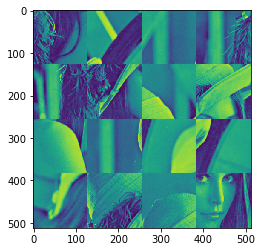

937.945877976854 291.3921604631861


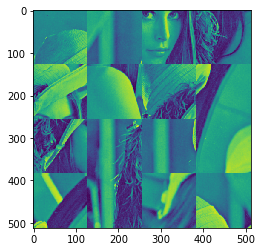

1072.3823147681214 289.9351996608702


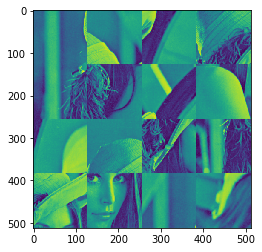

1122.2068432265398 288.4855236625658


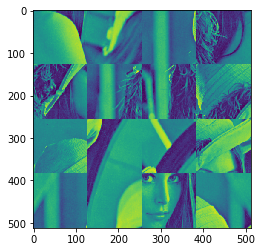

837.5881194474316 287.043096044253


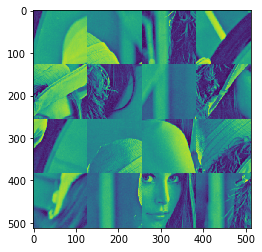

914.8916235840436 285.60788056403175


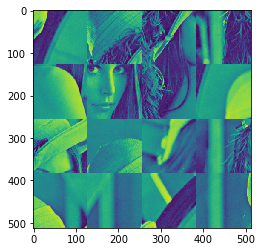

1166.2809553639943 284.1798411612116


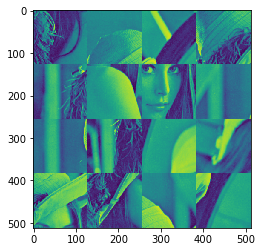

1005.1597309809497 282.75894195540553


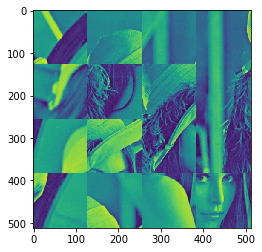

898.6263779092033 281.3451472456285


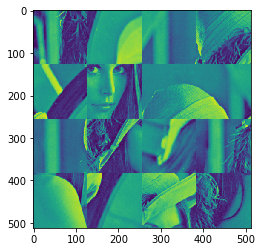

1033.0135208174192 279.9384215094003


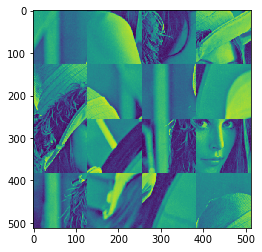

1072.0012129227766 278.5387294018533


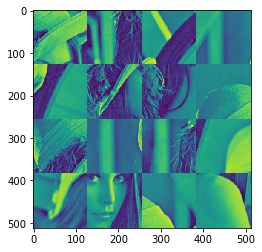

817.5028598323211 277.14603575484404


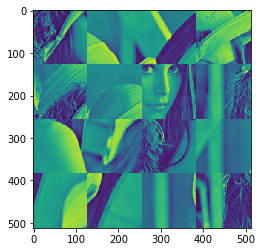

941.338557166455 275.7603055760698


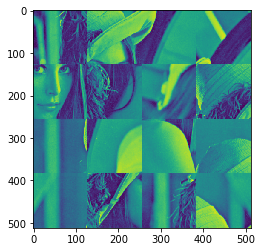

1077.2498920924245 274.38150404818947


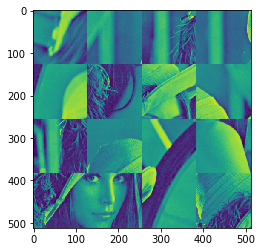

915.9442517473769 273.00959652794853


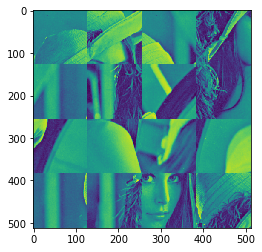

1139.6094141113322 271.6445485453088


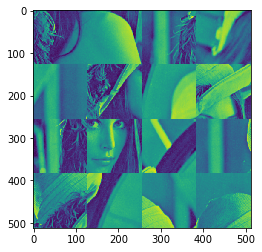

1033.347452880283 270.28632580258227


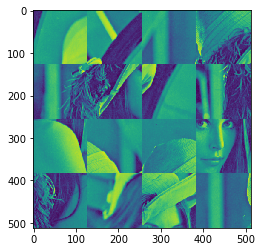

930.4175165479536 268.9348941735694


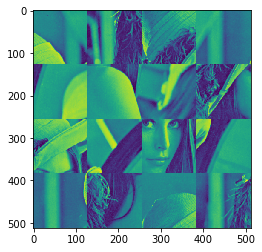

1084.9719137231968 267.5902197027015


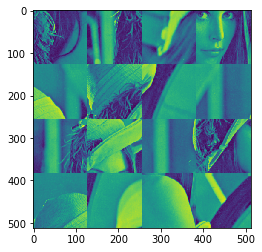

821.1764005092757 266.25226860418803


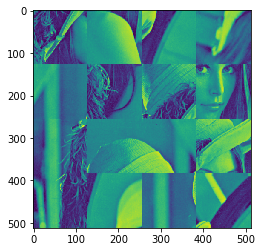

999.9807669925937 264.92100726116706


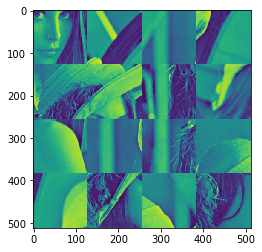

1093.2497130108754 263.5964022248612


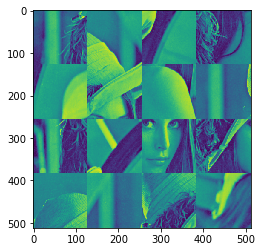

963.4385731113214 262.2784202137369


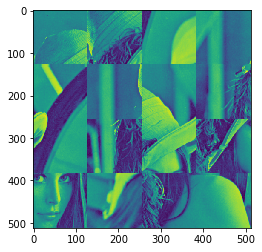

1092.6743498441074 260.96702811266823


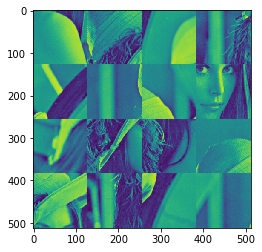

1012.1382764337624 259.6621929721049


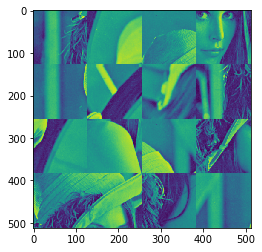

865.4181314594678 258.36388200724434


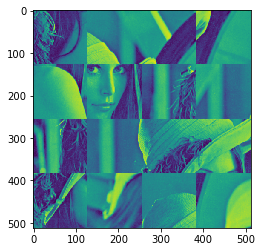

1097.5144766794813 257.0720625972081


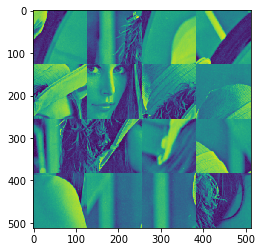

936.9911785523941 255.7867022842221


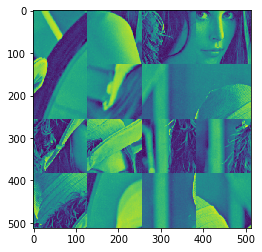

831.3604695838973 254.50776877280097


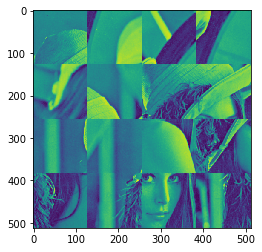

1066.863108348981 253.23522992893697


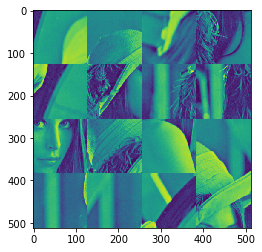

1294.6144689738596 251.9690537792923


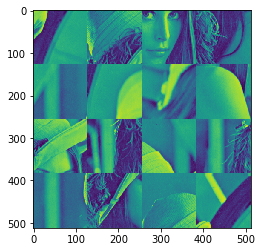

951.8454039025944 250.70920851039583


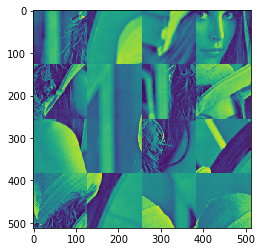

1026.3262509234078 249.45566246784384


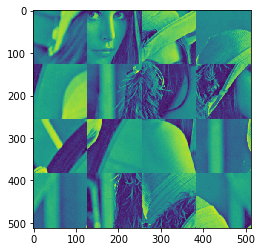

1147.2317911964167 248.2083841555046


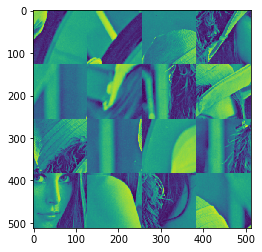

940.3479430561993 246.96734223472708


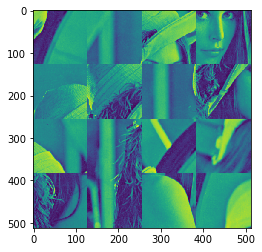

1051.4875246021886 245.73250552355344


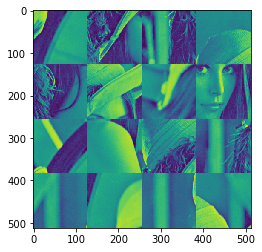

960.5434640452631 244.50384299593568


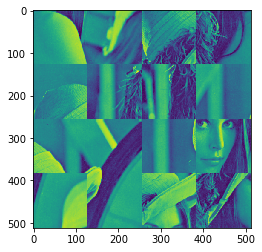

1066.2304853902979 243.281323780956


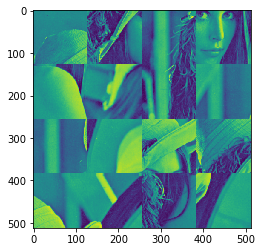

1129.8331838304794 242.06491716205122


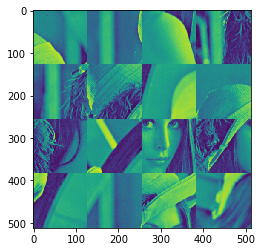

829.3864631822088 240.85459257624095


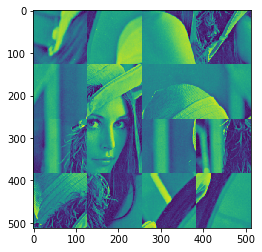

1030.6677576438165 239.65031961335973


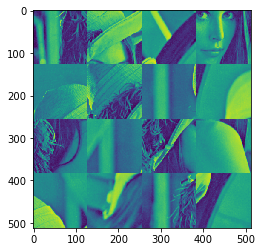

843.0617671075768 238.45206801529292


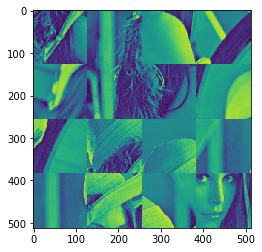

1001.7747419384123 237.25980767521645


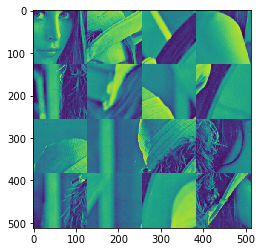

940.1557306770273 236.07350863684036


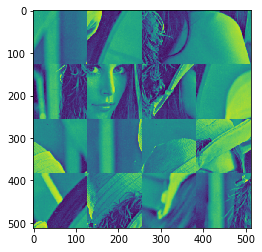

926.33563332521 234.89314109365617


KeyboardInterrupt: 

In [81]:
epochs = 500
c = 1000
best = mat
x = np.arange(0,4)
y = np.arange(0,4)

for epoch in range(1,epochs+1):
    
    old = best
    for e in range(50):
        new = old.copy()
        cost_old = Energy(image=old).energy()

        np.random.shuffle(x)
        np.random.shuffle(y)
        new[128*x[0]:128*x[0]+128, 128*y[0]:128*y[0]+128] = old[128*x[1]:128*x[1]+128, 128*y[1]:128*y[1]+128]
        new[128*x[1]:128*x[1]+128, 128*y[1]:128*y[1]+128] = old[128*x[0]:128*x[0]+128, 128*y[0]:128*y[0]+128]

        cost_new = Energy(image=new).energy()
        diff = cost_new - cost_old
        if diff:
            old = new

        elif np.random.rand()<np.exp(-diff/c):
            old = new
    
    if Energy(image=old).energy() <  Energy(image=best).energy():
        best=old
    
    c = c*0.995

    print(cost_new, c)
    plt.imshow(new)
    plt.show()


In [72]:
url = 'https://www.ece.rice.edu/~wakin/images/lenaTest2.jpg'
from PIL import Image
import urllib.request

im = Image.open(urllib.request.urlopen(url))

In [73]:
original = np.array(im)

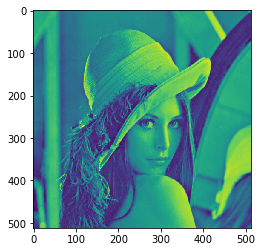

In [74]:
plt.imshow(original)

In [82]:
Energy(image=original).energy()

114.19761565709003

In [50]:
np.random.rand()

0.7680483474967663